# Getting the Path

In [1]:
import os
# constant path for images 
path = os.getcwd()

# Importing essential library

In [2]:
import os
import glob
import tensorflow as ts

2022-04-14 12:50:53.741217: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-04-14 12:50:53.741346: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


# Getting Test Images from folder
### 70% Test data

In [3]:
image_path_names=[]
person_names=set()
for file_name in glob.glob(os.path.join(path,'Images','[a-zA-Z0-9 .]*.jpg')):
    image_path_names.append(file_name)
    person_names.add(image_path_names[-1].split('/')[-1].split('_')[0]+image_path_names[-1].split('/')[-1].split('_')[1])
 
# total number of images 
len(image_path_names)

527

In [4]:
person_names

{'AlvaroUribe',
 'BillClinton',
 'GeorgeW',
 'JenniferLopez',
 'JoeLieberman',
 'JunichiroKoizumi',
 'MichaelBloomberg',
 'NaomiWatts',
 'RudolphGiuliani'}

# Importing Library

In [5]:
import cv2
import matplotlib.pyplot as plt
import dlib

# Getting CNN Face detector from dlib

In [6]:
# loading cnn face detector model 
dnnFaceDetector=dlib.cnn_face_detection_model_v1("mmod_human_face_detector.dat")

# Creating a directory for cropped images

In [7]:
# create a path for crop image 
if not os.path.exists(os.path.join(path,'Images_crop')):
    os.mkdir(os.path.join(path,'Images_crop'))
    
# For each person create a separate folder
for person in person_names:
    if not os.path.exists(os.path.join(path,'Images_crop',person)):
        os.mkdir(os.path.join(path,'Images_crop',person))

# Detecting the face, Cropping it and saving them in their corresponding names folder

In [8]:
# Detect face, crop detected face and save them in corresponding person folder
for file_name in image_path_names:
  img=cv2.imread(file_name)
  gray=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  rects=dnnFaceDetector(gray,1)
  left,top,right,bottom=0,0,0,0
  for (i,rect) in enumerate(rects):
    left=abs(rect.rect.left()) #x1
    top=abs(rect.rect.top()) #y1
    right=abs(rect.rect.right()) #x2
    bottom=abs(rect.rect.bottom()) #y2
    width=abs(right-left)
    height=abs(bottom-top)
    img_crop=img[top:top+height,left:left+width]
    img_path=os.path.join(path, 'Images_crop', file_name.split('/')[-1].split('_')[0]+file_name.split('/')[-1].split('_')[1], file_name.split('/')[-1])
    print(img_path)
    cv2.imwrite(img_path,img_crop)

/home/sarthak007/Personal_Projects/Face Recognition/Images_crop/GeorgeW/George_W_Bush_0145.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Images_crop/GeorgeW/George_W_Bush_0024.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Images_crop/AlvaroUribe/Alvaro_Uribe_0013.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Images_crop/GeorgeW/George_W_Bush_0276.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Images_crop/GeorgeW/George_W_Bush_0276.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Images_crop/GeorgeW/George_W_Bush_0200.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Images_crop/GeorgeW/George_W_Bush_0091.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Images_crop/GeorgeW/George_W_Bush_0091.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Images_crop/JunichiroKoizumi/Junichiro_Koizumi_0016.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Images_crop/MichaelBloomberg/Michael_Bloomberg_0004.jpg
/home/sarthak007/Pers

# Getting Testing Data (Image)

In [9]:
# Get Image names for testing
test_image_path_names=[]
for file_name in glob.glob(os.path.join(path,'Images_test','[a-zA-Z0-9 .]*.jpg')):
  test_image_path_names.append(file_name)
print(test_image_path_names)

['/home/sarthak007/Personal_Projects/Face Recognition/Images_test/George_W_Bush_0453.jpg', '/home/sarthak007/Personal_Projects/Face Recognition/Images_test/George_W_Bush_0390.jpg', '/home/sarthak007/Personal_Projects/Face Recognition/Images_test/George_W_Bush_0374.jpg', '/home/sarthak007/Personal_Projects/Face Recognition/Images_test/Michael_Bloomberg_0018.jpg', '/home/sarthak007/Personal_Projects/Face Recognition/Images_test/George_W_Bush_0427.jpg', '/home/sarthak007/Personal_Projects/Face Recognition/Images_test/Junichiro_Koizumi_0046.jpg', '/home/sarthak007/Personal_Projects/Face Recognition/Images_test/George_W_Bush_0516.jpg', '/home/sarthak007/Personal_Projects/Face Recognition/Images_test/George_W_Bush_0469.jpg', '/home/sarthak007/Personal_Projects/Face Recognition/Images_test/George_W_Bush_0425.jpg', '/home/sarthak007/Personal_Projects/Face Recognition/Images_test/George_W_Bush_0450.jpg', '/home/sarthak007/Personal_Projects/Face Recognition/Images_test/George_W_Bush_0527.jpg', '

In [10]:
len(test_image_path_names)

229

# Creating a Directory for Test crop

In [11]:
os.mkdir(path+'/Test_Images_crop/')

# Creating a Sperate folder for each name in Test Crop

In [12]:
# Create Separate folder for each person in "Test_Images_crop" folder
for person in person_names:
  os.mkdir(os.path.join(path,'Test_Images_crop',person))

# Detecting the face, cropping it and save them in corresponding names folder for test data

In [13]:
# Detect face,crop face and save in corresponding folder
for file_name in test_image_path_names:
  img=cv2.imread(file_name)
  gray=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  rects=dnnFaceDetector(gray,1)
  left,top,right,bottom=0,0,0,0
  for (i,rect) in enumerate(rects):
    left=abs(rect.rect.left()) #x1
    top=abs(rect.rect.top()) #y1
    right=abs(rect.rect.right()) #x2
    bottom=abs(rect.rect.bottom()) #y2
    width=abs(right-left)
    height=abs(bottom-top)
    img_crop=img[top:top+height,left:left+width]
    img_path=os.path.join(path, 'Test_Images_crop', file_name.split('/')[-1].split('_')[0]+file_name.split('/')[-1].split('_')[1], file_name.split('/')[-1])
    print(img_path)
    cv2.imwrite(img_path,img_crop)

/home/sarthak007/Personal_Projects/Face Recognition/Test_Images_crop/GeorgeW/George_W_Bush_0453.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Test_Images_crop/GeorgeW/George_W_Bush_0453.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Test_Images_crop/GeorgeW/George_W_Bush_0390.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Test_Images_crop/GeorgeW/George_W_Bush_0374.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Test_Images_crop/MichaelBloomberg/Michael_Bloomberg_0018.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Test_Images_crop/GeorgeW/George_W_Bush_0427.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Test_Images_crop/JunichiroKoizumi/Junichiro_Koizumi_0046.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Test_Images_crop/GeorgeW/George_W_Bush_0516.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Test_Images_crop/GeorgeW/George_W_Bush_0469.jpg
/home/sarthak007/Personal_Projects/Face Recognition/Test_Images_crop/Georg

# Importing Libraries

In [14]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras.layers import ZeroPadding2D,Convolution2D,MaxPooling2D
from tensorflow.keras.layers import Dense,Dropout,Softmax,Flatten,Activation,BatchNormalization
from tensorflow.keras.preprocessing.image import load_img,img_to_array
from tensorflow.keras.applications.imagenet_utils import preprocess_input
import tensorflow.keras.backend as K

# Creating a CNN Model

In [15]:
#Define VGG_FACE_MODEL architecture
model = Sequential()
model.add(ZeroPadding2D((1,1),input_shape=(224,224, 3)))
model.add(Convolution2D(64, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(128, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(256, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(256, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(256, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(ZeroPadding2D((1,1)))
model.add(Convolution2D(512, (3, 3), activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(Convolution2D(4096, (7, 7), activation='relu'))
model.add(Dropout(0.5))
model.add(Convolution2D(4096, (1, 1), activation='relu'))
model.add(Dropout(0.5))
model.add(Convolution2D(2622, (1, 1)))
model.add(Flatten())
model.add(Activation('softmax'))

2022-04-14 13:49:59.836081: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:936] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-04-14 13:49:59.838626: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-04-14 13:49:59.839046: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublas.so.11'; dlerror: libcublas.so.11: cannot open shared object file: No such file or directory
2022-04-14 13:49:59.839380: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublasLt.so.11'; dlerror: libcublasLt.so.11: cannot open shared object file: No such file or directory
2022-04-14 13:49:59.863737: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Co

# Loading Face model weights

In [16]:
# Load VGG Face model weights
model.load_weights('vgg_face_weights.h5')

2022-04-14 13:50:10.713894: W tensorflow/core/framework/cpu_allocator_impl.cc:82] Allocation of 411041792 exceeds 10% of free system memory.


In [17]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 zero_padding2d (ZeroPadding  (None, 226, 226, 3)      0         
 2D)                                                             
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 64)      1792      
                                                                 
 zero_padding2d_1 (ZeroPaddi  (None, 226, 226, 64)     0         
 ng2D)                                                           
                                                                 
 conv2d_1 (Conv2D)           (None, 224, 224, 64)      36928     
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 64)     0         
 )                                                               
                                                        

In [18]:
# Remove Last Softmax layer and get model upto last flatten layer with outputs 2622 units
vgg_face=Model(inputs=model.layers[0].input,outputs=model.layers[-2].output)

# Preparing the Training Data

In [39]:
from keras.utils import np_utils
#Prepare Training Data
x_train=[]
y_train=[]
person_folders=os.listdir(path+'/Images_crop/')
person_rep=dict()
for i,person in enumerate(person_folders):
  person_rep[i]=person
  image_names=os.listdir('Images_crop/'+person+'/')
  for image_name in image_names:
    img=load_img(path+'/Images_crop/'+person+'/'+image_name,target_size=(224,224))
    img=img_to_array(img)
    img=np.expand_dims(img,axis=0)
    img=preprocess_input(img)
    img_encode=vgg_face(img)
    x_train.append(np.squeeze(K.eval(img_encode)).tolist())
    y_train.append(i)
# x_train = np.array(x_train)
# x_train.shape
print("Below is x train")
# x_train = np_utils.to_categorical(x_train, num_classes=6)
x_train
print("Below is y train")
# y_train = np.array(y_train)
# y_train.shape
# y_train = np_utils.to_categorical(y_train, num_classes=6)
y_train

Below is x train
Below is y train


[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,


In [40]:
person_rep

{0: 'BillClinton',
 1: 'NaomiWatts',
 2: 'AlvaroUribe',
 3: 'RudolphGiuliani',
 4: 'GeorgeW',
 5: 'JunichiroKoizumi',
 6: 'JenniferLopez',
 7: 'MichaelBloomberg',
 8: 'JoeLieberman'}

# Preparing the Test Data

In [41]:
#Prepare Test Data
x_test=[]
y_test=[]
person_folders=os.listdir(path+'/Test_Images_crop/')
for i,person in enumerate(person_folders):
  image_names=os.listdir('Test_Images_crop/'+person+'/')
  for image_name in image_names:
    img=load_img(path+'/Test_Images_crop/'+person+'/'+image_name,target_size=(224,224))
    img=img_to_array(img)
    img=np.expand_dims(img,axis=0)
    img=preprocess_input(img)
    img_encode=vgg_face(img)
    x_test.append(np.squeeze(K.eval(img_encode)).tolist())
    y_test.append(i)

In [42]:
x_test=np.array(x_test)
y_test=np.array(y_test)
x_test
y_test

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 7,
       7, 7, 7, 7, 7, 8, 8, 8, 8])

# Saving the Training and Testing Data for later Usage

In [43]:
# Save test and train data for later use
np.save('train_data',x_train)
np.save('train_labels',y_train)
np.save('test_data',x_test)
np.save('test_labels',y_test)

# Loading saved data

In [52]:
# Load saved data
x_train=np.load('train_data.npy')
y_train=np.load('train_labels.npy')
x_test=np.load('test_data.npy')
y_test=np.load('test_labels.npy')
# y_train = np_utils.to_categorical(y_train,num_classes=9)
# y_test = np_utils.to_categorical(y_test, num_classes=9)
y_train
y_test

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 7,
       7, 7, 7, 7, 7, 8, 8, 8, 8])

In [57]:
# Softmax regressor to classify images based on encoding 
classifier_model=Sequential()
classifier_model.add(Dense(units=100,input_dim=x_train.shape[1],kernel_initializer='glorot_uniform'))
classifier_model.add(BatchNormalization())
classifier_model.add(Activation('tanh'))
classifier_model.add(Dropout(0.3))
classifier_model.add(Dense(units=10,kernel_initializer='glorot_uniform'))
classifier_model.add(BatchNormalization())
classifier_model.add(Activation('tanh'))
classifier_model.add(Dropout(0.2))
classifier_model.add(Dense(units=9,kernel_initializer='he_uniform'))
classifier_model.add(Activation('softmax'))
classifier_model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(),optimizer='nadam',metrics=['accuracy'])

In [58]:
classifier_model.fit(x_train,y_train,epochs=100,validation_data=(x_test,y_test))

Epoch 1/100
17/17 [==============================] - 4s 63ms/step - loss: 1.6572 - accuracy: 0.5085 - val_loss: 1.0583 - val_accuracy: 0.7249
Epoch 2/100
17/17 [==============================] - 0s 18ms/step - loss: 1.2686 - accuracy: 0.6945 - val_loss: 1.2528 - val_accuracy: 0.7424
Epoch 3/100
17/17 [==============================] - 0s 19ms/step - loss: 1.1107 - accuracy: 0.7723 - val_loss: 1.2691 - val_accuracy: 0.8253
Epoch 4/100
17/17 [==============================] - 0s 19ms/step - loss: 0.9648 - accuracy: 0.8065 - val_loss: 0.7968 - val_accuracy: 0.9170
Epoch 5/100
17/17 [==============================] - 0s 18ms/step - loss: 0.9199 - accuracy: 0.8425 - val_loss: 2.0498 - val_accuracy: 0.3537
Epoch 6/100
17/17 [==============================] - 0s 18ms/step - loss: 0.8638 - accuracy: 0.8482 - val_loss: 1.1192 - val_accuracy: 0.8559
Epoch 7/100
17/17 [==============================] - 0s 20ms/step - loss: 0.7368 - accuracy: 0.8956 - val_loss: 1.5526 - val_accuracy: 0.5983
Epoch 

In [59]:
# Path to folder which contains images to be tested and predicted
test_images_path=path+'/Test_Images/'

In [60]:
dnnFaceDetector=dlib.cnn_face_detection_model_v1("mmod_human_face_detector.dat")

In [61]:
def plot(img):
  plt.figure(figsize=(8,4))
  plt.imshow(img[:,:,::-1])
  plt.show()

In [65]:
# Label names for class numbers
person_rep={0:'Bill Clinton',1:'Naomi Watts',2:'Alvaro Uribe',3:'Rudolph Giuliani',4:'George W Bush',5:'Junichiro Koizumi',6:'Jennifer Lopez',7:'Michael Bloomberg',8:'Joe Lieberman'}

# Creating the directory for Predictions

In [67]:
os.mkdir(path+'/Predictions')

# Loading Images, Detecting faces, extract each face and making predictions

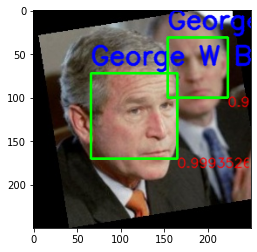

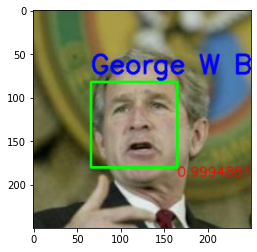

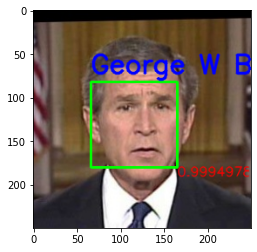

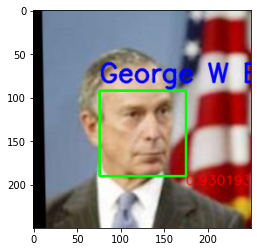

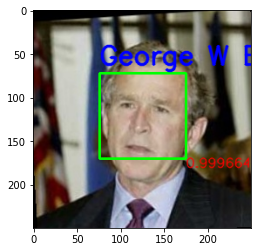

...

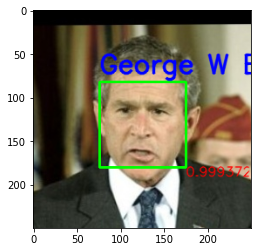

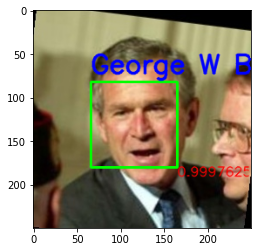

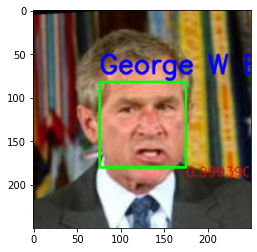

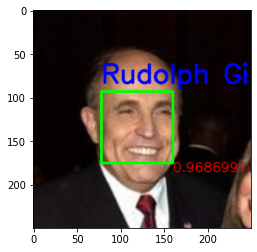

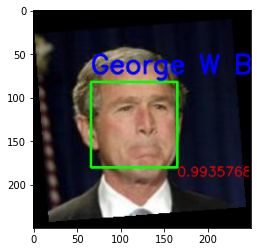

In [69]:
for img_name in os.listdir('Images_test/'):
  if img_name=='crop_img.jpg':
    continue
  # Load Image
  img=cv2.imread(path+'/Images_test/'+img_name)
  gray=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  # Detect Faces
  rects=dnnFaceDetector(gray,1)
  left,top,right,bottom=0,0,0,0
  for (i,rect) in enumerate(rects):
    # Extract Each Face
    left=abs(rect.rect.left()) #x1
    top=abs(rect.rect.top()) #y1
    right=abs(rect.rect.right()) #x2
    bottom=abs(rect.rect.bottom()) #y2
    width=abs(right-left)
    height=abs(bottom-top)
    img_crop=img[top:top+height,left:left+width]
    cv2.imwrite(path+'/Images_test/crop_img.jpg',img_crop)
    
    # Get Embeddings
    crop_img=load_img(path+'/Images_test/crop_img.jpg',target_size=(224,224))
    crop_img=img_to_array(crop_img)
    crop_img=np.expand_dims(crop_img,axis=0)
    crop_img=preprocess_input(crop_img)
    img_encode=vgg_face(crop_img)

    # Make Predictions
    embed=K.eval(img_encode)
    person=classifier_model.predict(embed)
    name=person_rep[np.argmax(person)]
    os.remove(path+'/Images_test/crop_img.jpg')
    cv2.rectangle(img,(left,top),(right,bottom),(0,255,0), 2)
    img=cv2.putText(img,name,(left,top-10),cv2.FONT_HERSHEY_SIMPLEX,1,(255,0,0),2,cv2.LINE_AA)
    img=cv2.putText(img,str(np.max(person)),(right,bottom+10),cv2.FONT_HERSHEY_SIMPLEX,0.5,(0,0,255),1,cv2.LINE_AA)
  # Save images with bounding box,name and accuracy 
  cv2.imwrite(path+'/Predictions/'+img_name,img)
  plot(img)